In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import cv2
import random
import json
from PIL import Image
import os
from torch.utils.data import Dataset, DataLoader
import torch, torchvision
import warnings
from skimage import io
import numpy as np
from albumentations.pytorch.transforms import ToTensor
import albumentations as A
import pandas as pd
from tqdm.notebook import tqdm

warnings.filterwarnings("ignore")
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
import shutil
from tqdm import tqdm
from matplotlib import pyplot as plt
import torch.optim as optim
from torch.optim import lr_scheduler
import torchvision
from torchvision import datasets, models, transforms


In [3]:
import torch
from torch import nn

# If there's a GPU available...
if torch.cuda.is_available():

    # Tell PyTorch to use the GPU.    
    device = torch.device("cuda")

    print('There are %d GPU(s) available.' % torch.cuda.device_count())

    print('We will use the GPU:', torch.cuda.get_device_name(0))

# If not...
else:
    print('No GPU available, using the CPU instead.')
    device = torch.device("cpu")

There are 1 GPU(s) available.
We will use the GPU: NVIDIA GeForce RTX 4090


In [4]:
def plot_images(images_for_show, titles=None):
  """Строит изображение на одном графике"""
  fig = plt.figure(figsize=(16, 16))

  columns = len(images_for_show)
  rows = 1
  for i in range(1, columns*rows +1):
    ax = fig.add_subplot(rows, columns, i)
    if titles is not None:
      ax.title.set_text(titles[i - 1])
    plt.xticks([])
    plt.yticks([])
    plt.imshow(images_for_show[i - 1])
    
  fig.subplots_adjust(wspace=0.1, hspace=0)
  plt.show()

## Train cartoon stylegan3

In [4]:
!pip3 install Ninja -q


[notice] A new release of pip is available: 24.2 -> 25.0.1
[notice] To update, run: python3 -m pip install --upgrade pip


In [ ]:
# !git clone https://github.com/NVlabs/stylegan3

In [ ]:
# !wget https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/stylegan3-r-ffhq-1024x1024.pkl -O models/stylegan3-r-ffhq-1024x1024.pkl

In [44]:
!python stylegan3/gen_images.py \
  --outdir=out \
  --trunc=1 \
  --seeds=2,4,6 \
  --network=models/stylegan3-r-ffhq-1024x1024.pkl


Loading networks from "models/stylegan3-r-ffhq-1024x1024.pkl"...
Generating image for seed 2 (0/3) ...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "filtered_lrelu_plugin"... Done.
Generating image for seed 4 (1/3) ...
Generating image for seed 6 (2/3) ...


In [217]:
!python3 stylegan3/dataset_tool.py --source='cartoonset_jpg/0/' --dest='cartoon_for_train' --resolution='1024x1024' --max-images=1000

100%|███████████████████████████████████████| 1000/1000 [01:47<00:00,  9.34it/s]


In [1]:
# !python3 stylegan3/train.py --outdir stylegan3/training_output --data cartoon_for_train --cfg=stylegan3-r --gpus=1 --batch=32 --gamma=8 --batch-gpu=4 --snap=2 --resume models/stylegan3-r-ffhq-1024x1024.pkl --kimg=1000 --metrics none

In [ ]:
# !mv stylegan3/training_output/network-snapshot.pkl models/stylegan3-r-ffhq-1024x1024-cartoon.pkl

## Import libraries

In [5]:
import sys
sys.path.append('stylegan3')

In [6]:
import os
import re
from typing import List, Optional, Tuple, Union
from gen_images import make_transform
import dnnlib
import numpy as np
import PIL.Image
import torch
import matplotlib.pyplot as plt

import legacy

## Blenging models

In [7]:
import dnnlib
import legacy
from torch_utils import misc
from train import init_dataset_kwargs


def blend(path1, path2, blend=[1] * 15):
    training_set_kwargs, _ = init_dataset_kwargs(data='cartoon')
    training_set = dnnlib.util.construct_class_by_name(**training_set_kwargs)  # subclass of training.dataset.Dataset

    G_kwargs = dnnlib.EasyDict(class_name=None, z_dim=512, w_dim=512, mapping_kwargs=dnnlib.EasyDict())
    G_kwargs.channel_base = 32768
    G_kwargs.channel_max = 512
    G_kwargs.mapping_kwargs.num_layers = 2
    G_kwargs.class_name = 'training.networks_stylegan3.Generator'
    G_kwargs.magnitude_ema_beta = 0.5 ** (64 / (20 * 1e3))
    G_kwargs.conv_kernel = 1  # Use 1x1 convolutions.
    G_kwargs.channel_base *= 2  # Double the number of feature maps.
    G_kwargs.channel_max *= 2
    G_kwargs.use_radial_filters = True

    common_kwargs = dict(c_dim=training_set.label_dim, img_resolution=training_set.resolution,
                         img_channels=training_set.num_channels)

    G1 = dnnlib.util.construct_class_by_name(**G_kwargs, **common_kwargs).requires_grad_(False)
    G2 = dnnlib.util.construct_class_by_name(**G_kwargs, **common_kwargs).requires_grad_(False)

    with dnnlib.util.open_url(path1) as f:
        resume_data = legacy.load_network_pkl(f)
    misc.copy_params_and_buffers(resume_data['G_ema'], G1, require_all=False)

    with dnnlib.util.open_url(path2) as f:
        resume_data = legacy.load_network_pkl(f)
    misc.copy_params_and_buffers(resume_data['G_ema'], G2, require_all=False)

    state_dict1 = G1.synthesis.state_dict()
    state_dict2 = G2.synthesis.state_dict()

    # blend = [0.5, 0.5, 0.5, 0.6, 0.6, 0.7, 0.7, 0.9, 0.9, 1, 1, 1, 1, 1, 1]

    for key in state_dict2:
        if key[:1] != 'L':
            continue
        l = blend[int(key.split('_')[0][1:])]
        if 'affine' in key:
            l = 0

        state_dict1[key] = state_dict1[key] * l + state_dict2[key] * (1 - l)

    G1.synthesis.load_state_dict(state_dict1)

    return G1

## Label dataset for classification model

In [40]:
from tqdm import tqdm

In [42]:
outdir = 'data/my-fake-faces'

os.makedirs(outdir, exist_ok=True)

blended_models = {
                'real': blend('models/stylegan3-r-ffhq-1024x1024.pkl', 'models/stylegan3-r-ffhq-1024x1024.pkl'),
                }

seeds = np.random.randint(0, 1e6, (10000))

for name, G in blended_models.items():
  G = G.to(device)
  for seed in tqdm(seeds):
      z = torch.from_numpy(np.random.RandomState(seed).randn(1, G.z_dim)).to(device)

      if hasattr(G.synthesis, 'input'):
          m = make_transform((0, 0), 0)
          m = np.linalg.inv(m)
          G.synthesis.input.transform.copy_(torch.from_numpy(m))

      img = G(z, torch.zeros([1, G.c_dim], device=device), truncation_psi=1, noise_mode='const')
      img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
      PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB').save(f'{outdir}/{name}/seed_{seed}.jpg')

100%|██████████| 10000/10000 [10:45<00:00, 15.49it/s]


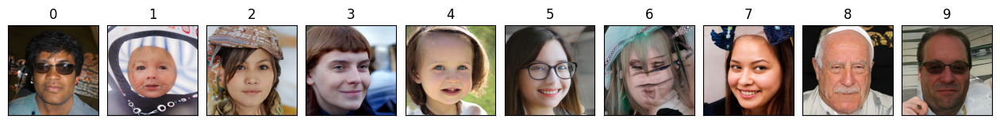

 126


Labels: [False, True, True, False, False, False, True, False, False, False]


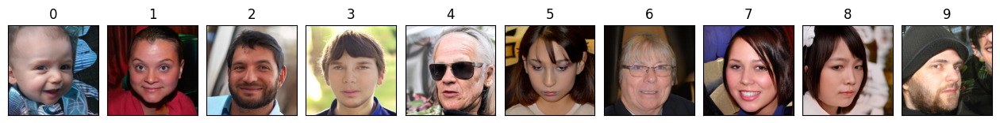

 0


Labels: [True, False, False, False, False, False, False, False, False, False]


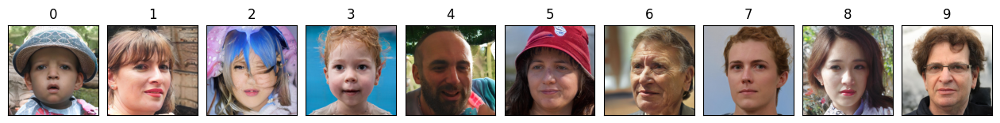

 12


Labels: [False, True, True, False, False, False, False, False, False, False]


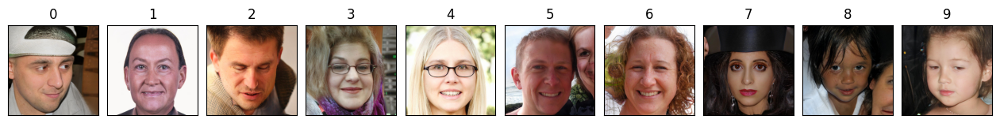

 058


Labels: [True, False, False, False, False, True, False, False, True, False]


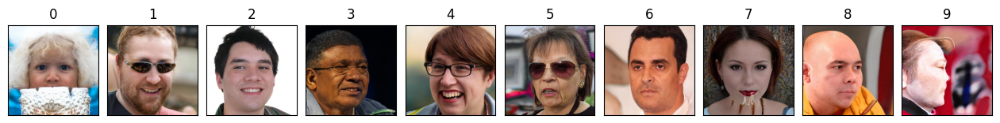

 079


Labels: [True, False, False, False, False, False, False, True, False, True]


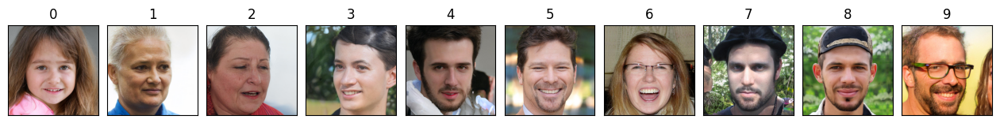

 479


Labels: [False, False, False, False, True, False, False, True, False, True]


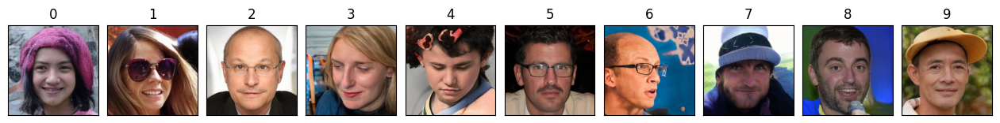

 146


Labels: [False, True, False, False, True, False, True, False, False, False]


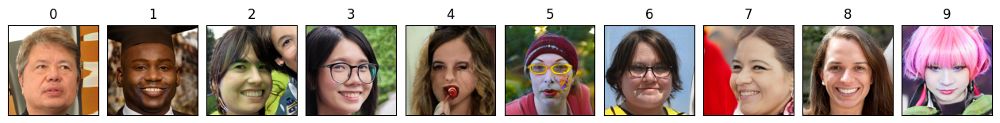

 245


Labels: [False, False, True, False, True, True, False, False, False, False]


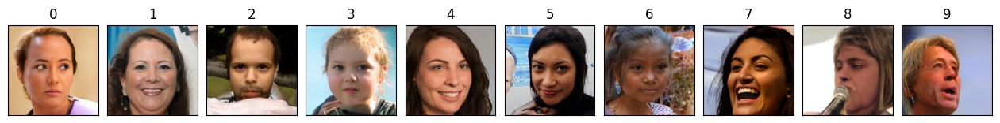

 258


Labels: [False, False, True, False, False, True, False, False, True, False]


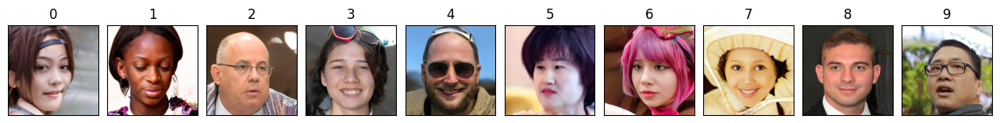

 63


Labels: [False, False, False, True, False, False, True, False, False, False]


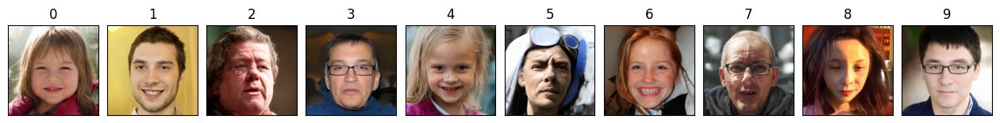

 56


Labels: [False, False, False, False, False, True, True, False, False, False]


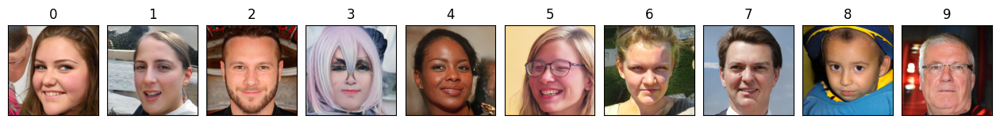

 03


Labels: [True, False, False, True, False, False, False, False, False, False]


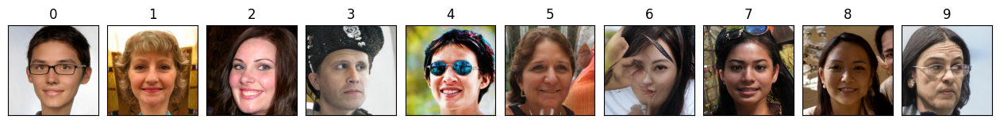

 6785


Labels: [False, False, False, False, False, True, True, True, True, False]


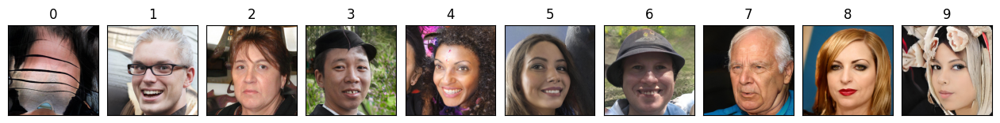

 0159


Labels: [True, True, False, False, False, True, False, False, False, True]


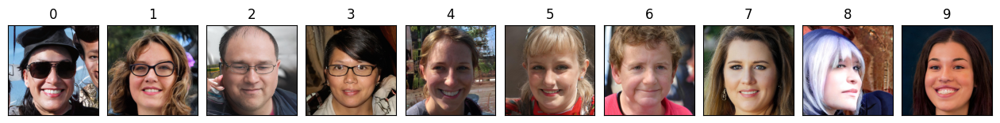

 08


Labels: [True, False, False, False, False, False, False, False, True, False]


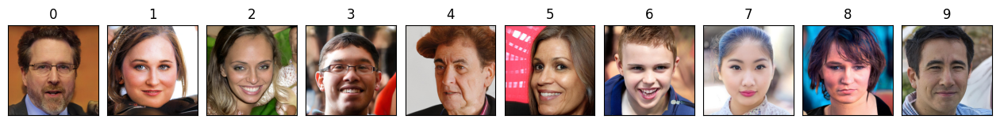

 152


Labels: [False, True, True, False, False, True, False, False, False, False]


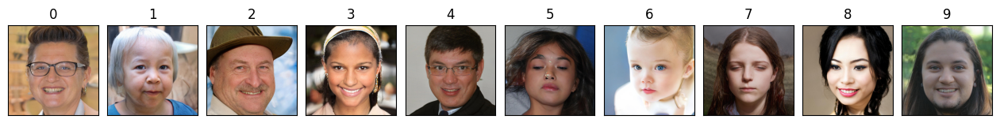

Labels: [False, False, False, False, False, False, False, False, False, False]


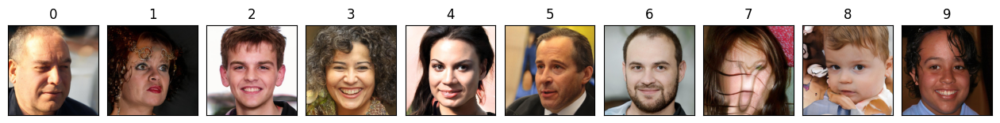

 178


Labels: [False, True, False, False, False, False, False, True, True, False]


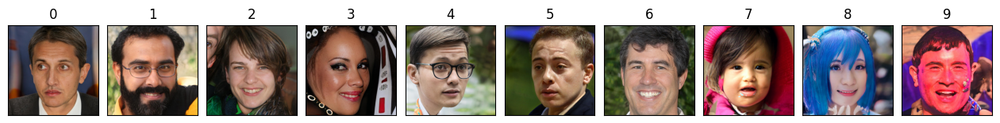

 1497


Labels: [False, True, False, False, True, False, False, True, False, True]


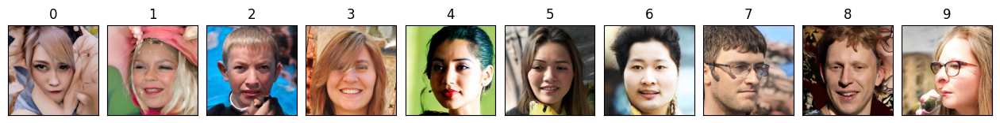

 012897


Labels: [True, True, True, False, False, False, False, True, True, True]


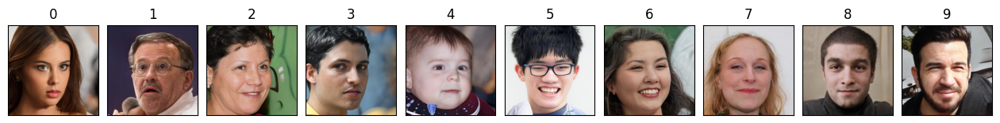

 2


Labels: [False, False, True, False, False, False, False, False, False, False]


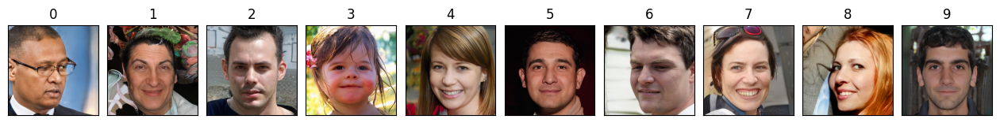

 18


Labels: [False, True, False, False, False, False, False, False, True, False]


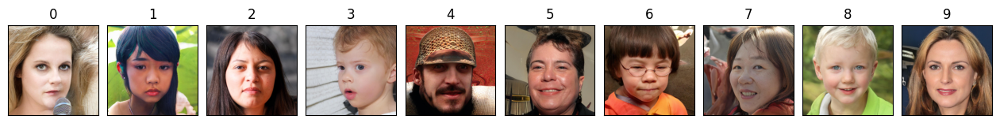

 0347


Labels: [True, False, False, True, True, False, False, True, False, False]


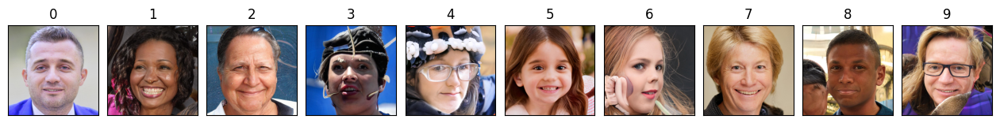

 13689


Labels: [False, True, False, True, False, False, True, False, True, True]


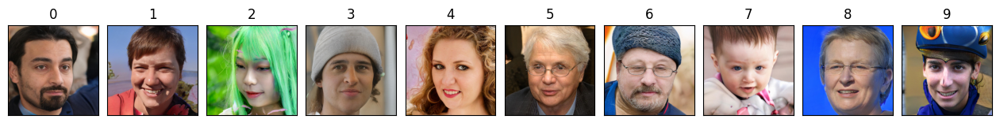

 29


Labels: [False, False, True, False, False, False, False, False, False, True]


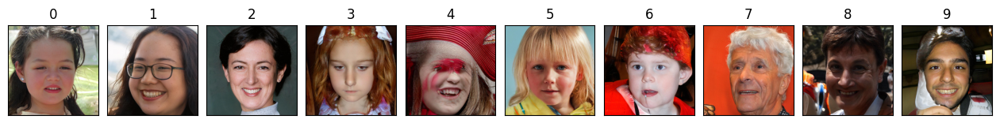

 46


Labels: [False, False, False, False, True, False, True, False, False, False]


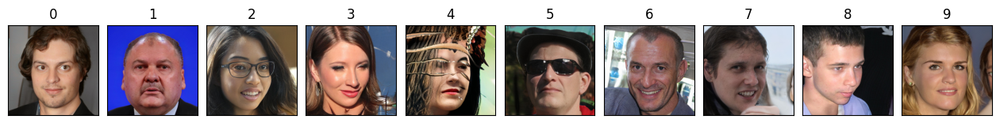

 347


Labels: [False, False, False, True, True, False, False, True, False, False]


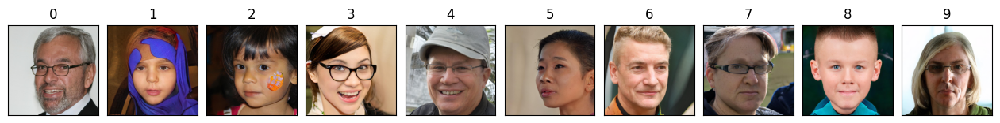

 13


Labels: [False, True, False, True, False, False, False, False, False, False]


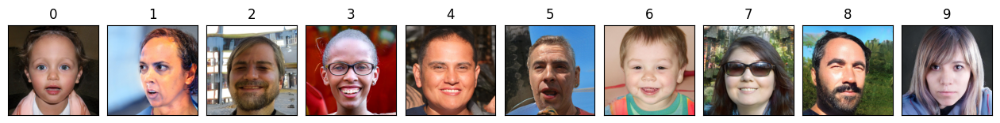

 2


Labels: [False, False, True, False, False, False, False, False, False, False]


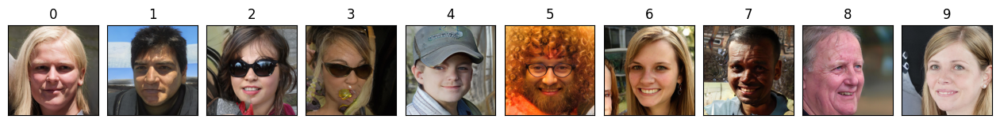

 3546


Labels: [False, False, False, True, True, True, True, False, False, False]


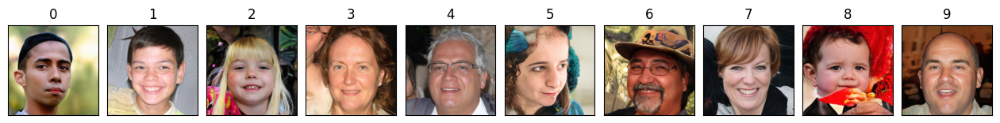

 258


Labels: [False, False, True, False, False, True, False, False, True, False]


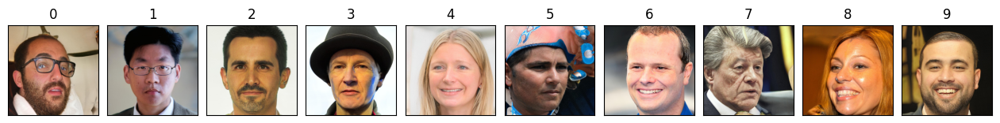

 50


Labels: [True, False, False, False, False, True, False, False, False, False]


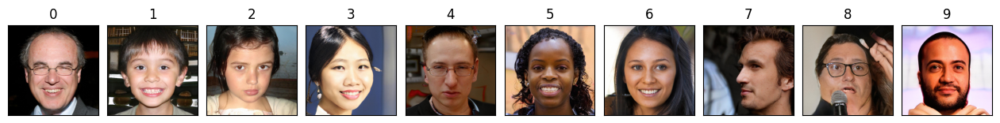

 78


Labels: [False, False, False, False, False, False, False, True, True, False]


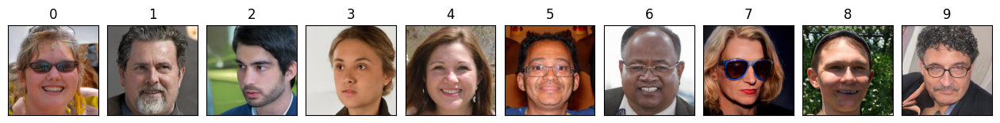

 0


Labels: [True, False, False, False, False, False, False, False, False, False]


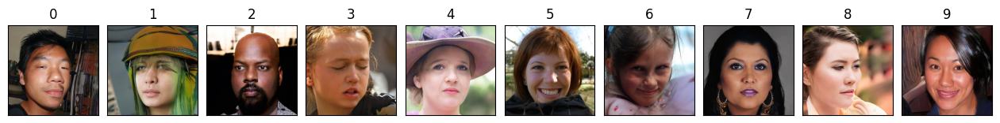

 016


Labels: [True, True, False, False, False, False, True, False, False, False]


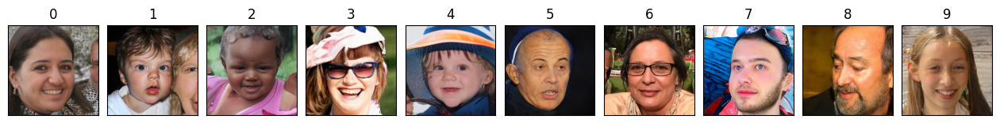

 013


Labels: [True, True, False, True, False, False, False, False, False, False]


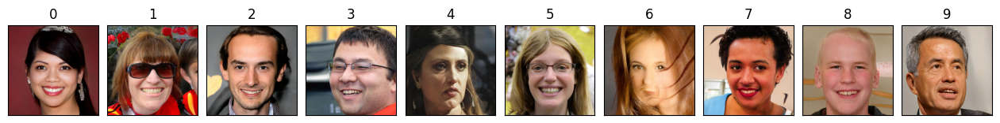

 16


Labels: [False, True, False, False, False, False, True, False, False, False]


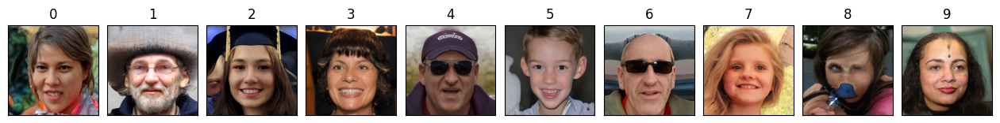

 01289


Labels: [True, True, True, False, False, False, False, False, True, True]


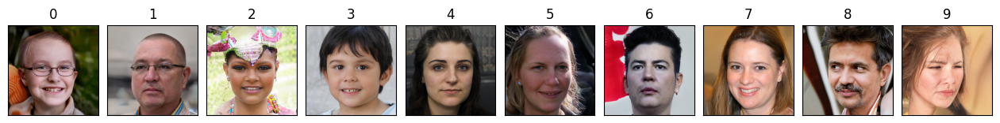

 029


Labels: [True, False, True, False, False, False, False, False, False, True]


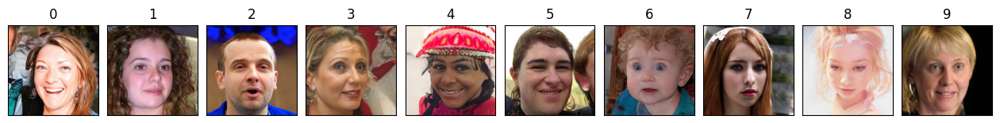

 0345


Labels: [True, False, False, True, True, True, False, False, False, False]


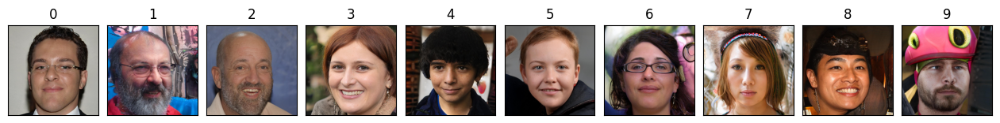

 1679


Labels: [False, True, False, False, False, False, True, True, False, True]


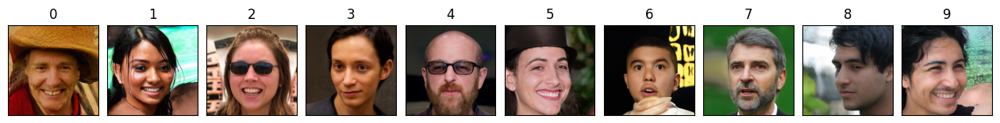

 19


Labels: [False, True, False, False, False, False, False, False, False, True]


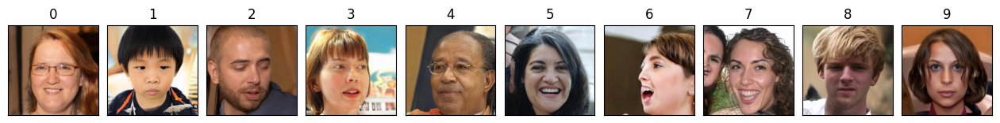

 76


Labels: [False, False, False, False, False, False, True, True, False, False]


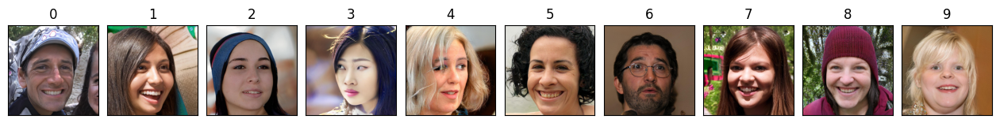

 0143


Labels: [True, True, False, True, True, False, False, False, False, False]


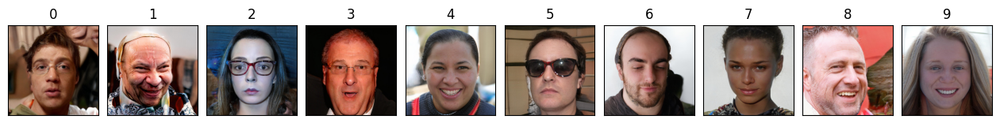

 0168


Labels: [True, True, False, False, False, False, True, False, True, False]


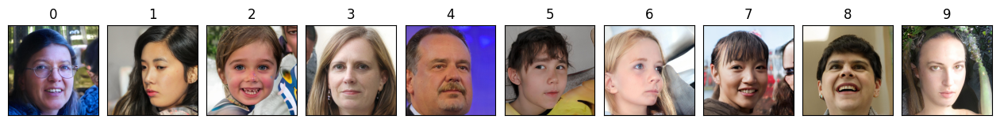

 0267


Labels: [True, False, True, False, False, False, True, True, False, False]


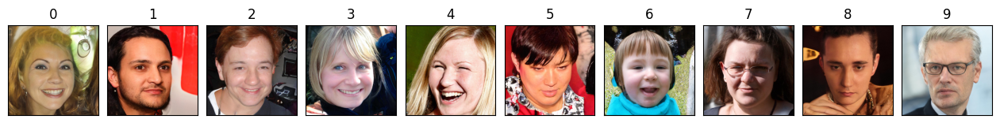

 03


Labels: [True, False, False, True, False, False, False, False, False, False]


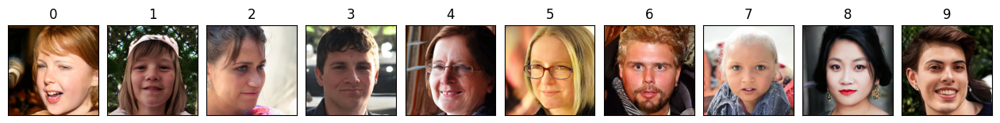

Labels: [False, False, False, False, False, False, False, False, False, False]


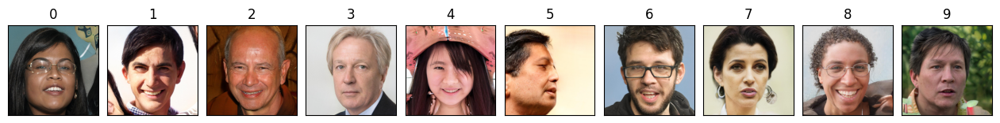

 45


Labels: [False, False, False, False, True, True, False, False, False, False]


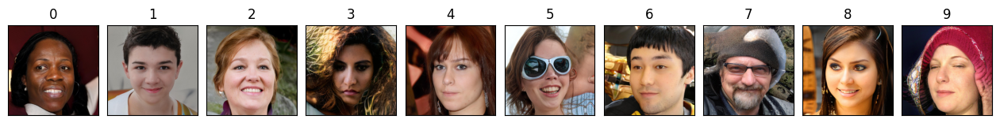

 3579


Labels: [False, False, False, True, False, True, False, True, False, True]


In [117]:
import builtins

outdir = 'data/my-fake-faces/real'
labels = []
paths = []
batch_size = 10
cur_images = []

for filename in os.listdir(outdir)[:500]:
    paths.append(os.path.join(outdir, filename))
    image = cv2.imread(os.path.join(outdir, filename))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    cur_images.append(image)
    if len(cur_images) % batch_size == 0:
        plot_images(cur_images, list(range(batch_size)))
        cur_images = []
        x = builtins.input()
        for i in range(10):
            labels.append(chr(ord('0') + i) in x)
        print('Labels:', labels[-batch_size:])

In [119]:
len(labels), len(paths)

(500, 500)

In [120]:
pd.DataFrame({'path': paths, 'label': labels}).to_csv('labeled_bad_faces.csv', index=False)

## Load fake detection model

In [8]:
from torchvision import datasets, models, transforms
import albumentations as A

filtration_model = models.resnet50(pretrained=True)

filtration_model.fc = nn.Sequential(
    nn.Linear(2048, 256),
    nn.ReLU(),
    nn.Linear(256, 1),
    nn.Sigmoid()
)

In [9]:
filtration_model.load_state_dict(torch.load('models/bad_face_detection.pt'))
filtration_model = filtration_model.to(device).eval()

In [10]:
transforms = A.Compose([
      A.Resize(256, 256),
      A.Normalize(),
      ToTensor()
])

def predict_image(x):
    input = transforms(image=x)['image'].to(device)
    input = input.reshape(-1, *input.shape)
    # input = torch.Tensor([input])
    pred = filtration_model(input)[0]
    return pred[0].item()

# image = cv2.imread('data/my-fake-faces/real/seed_644497.jpg')
# image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
# predict_image(image)
# plot_images([A.Resize(256, 256)(image=image)['image']], ['1'])

## Some samples to select best blend

In [26]:
outdir = 'out'

# G = blend('models/stylegan3-r-ffhq-1024x1024.pkl', 'models/stylegan3-r-ffhq-1024x1024-cartoon.pkl')
os.makedirs(outdir, exist_ok=True)
real_model_path = 'models/stylegan3-r-ffhq-1024x1024.pkl'
cartoon_model_path = 'models/stylegan3-r-ffhq-1024x1024-cartoon.pkl'

blended_models = {#'merged_rev': blend('models/stylegan3-r-ffhq-1024x1024.pkl', 'models/stylegan3-r-ffhq-1024x1024-cartoon.pkl'),
                  'real': blend(real_model_path, cartoon_model_path),
                  'merged_1': blend(real_model_path, cartoon_model_path, 
                                    blend = [0.2, 0.3, 0.4, 0.5, 0.5, 0.6, 0.6, 0.7, 0.7, 0.8, 0.8, 0.9, 0.9, 1, 1]),
                  'merged_2': blend(real_model_path, cartoon_model_path, 
                                    blend = [0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1, 1, 1, 1, 1, 1, 1, 1]),
                  'merged_3': blend(real_model_path, cartoon_model_path, 
                                    blend = [0.5, 0.5, 0.5, 0.6, 0.6, 0.7, 0.7, 0.9, 0.9, 1, 1, 1, 1, 1, 1]),
                  'merged_4': blend(real_model_path, cartoon_model_path, 
                                    blend = [0.5, 0.6, 0.7, 0.8, 0.9, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
                  'merged_5': blend(real_model_path, cartoon_model_path, 
                                    blend = [0.6, 0.7, 0.8, 0.9, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
                  'merged_6': blend(real_model_path, cartoon_model_path, 
                                    blend = [0.7, 0.8, 0.9, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
                  'cartoon': blend(cartoon_model_path, cartoon_model_path)}
}

images = {}
seeds = np.random.randint(0, 10000, (20))

for name, G in blended_models.items():
  G = G.to(device)
  # Generate images.
  now_images = []
  for seed_idx, seed in enumerate(seeds):
      print('Generating image for seed %d (%d/%d) ...' % (seed, seed_idx, len(seeds)))
      z = torch.from_numpy(np.random.RandomState(seed).randn(1, G.z_dim)).to(device)

      # Construct an inverse rotation/translation matrix and pass to the generator.  The
      # generator expects this matrix as an inverse to avoid potentially failing numerical
      # operations in the network.
      if hasattr(G.synthesis, 'input'):
          m = make_transform((0, 0), 0)
          m = np.linalg.inv(m)
          G.synthesis.input.transform.copy_(torch.from_numpy(m))

      img = G(z, torch.zeros([1, G.c_dim], device=device), truncation_psi=1, noise_mode='const')
      img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
      now_images.append(img[0].cpu().numpy())
      
      # PIL.Image.fromarray(img[0].cpu().numpy(), 'RGB').save(f'{outdir}/seed{seed:04d}_{name}.png')
  images[name] = now_images

Generating image for seed 4346 (0/20) ...
Generating image for seed 3641 (1/20) ...
Generating image for seed 3586 (2/20) ...
Generating image for seed 6969 (3/20) ...
Generating image for seed 4827 (4/20) ...
Generating image for seed 7191 (5/20) ...
Generating image for seed 7027 (6/20) ...
Generating image for seed 1796 (7/20) ...
Generating image for seed 4562 (8/20) ...
Generating image for seed 8007 (9/20) ...
Generating image for seed 2334 (10/20) ...
Generating image for seed 9765 (11/20) ...
Generating image for seed 5038 (12/20) ...
Generating image for seed 4494 (13/20) ...
Generating image for seed 1164 (14/20) ...
Generating image for seed 2424 (15/20) ...
Generating image for seed 7893 (16/20) ...
Generating image for seed 8762 (17/20) ...
Generating image for seed 103 (18/20) ...
Generating image for seed 3036 (19/20) ...
Generating image for seed 4346 (0/20) ...
Generating image for seed 3641 (1/20) ...
Generating image for seed 3586 (2/20) ...
Generating image for seed

0.47966840863227844


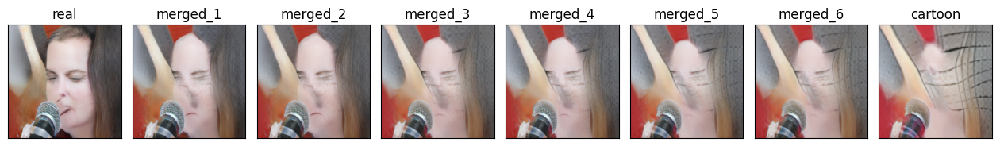

0.4348618984222412


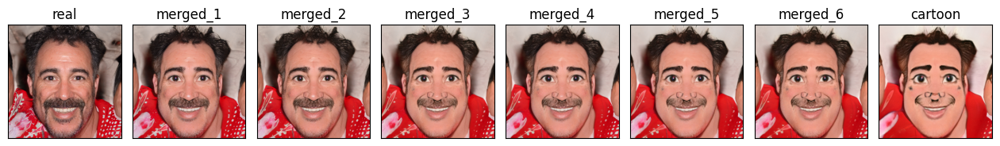

0.12358051538467407


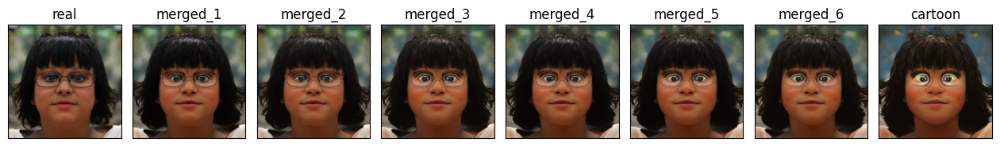

0.5157226324081421


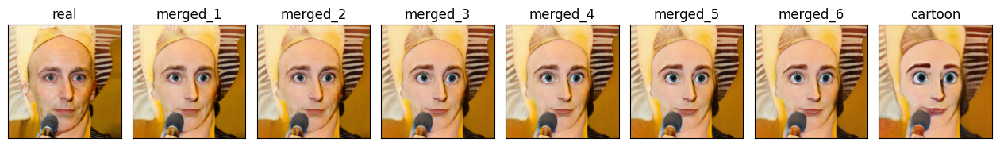

0.28552889823913574


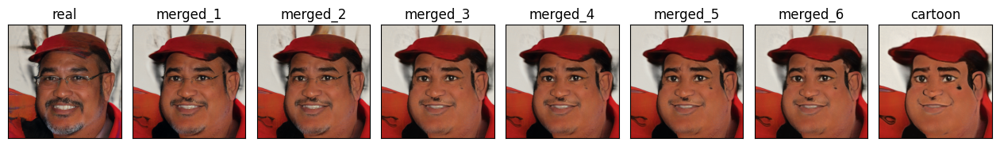

0.27715519070625305


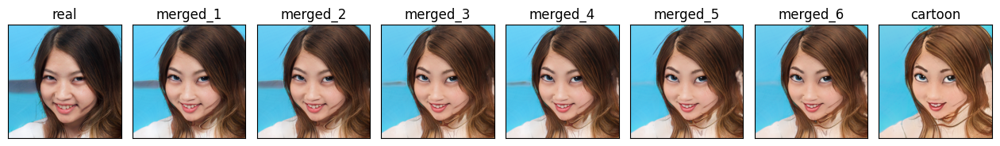

0.3455830514431


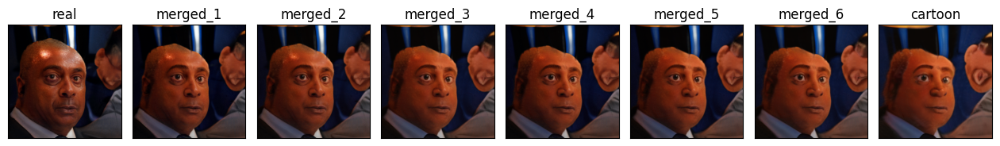

0.4484139382839203


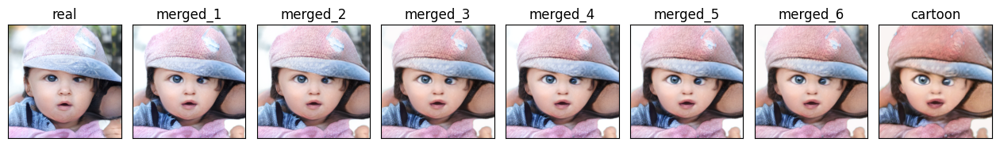

0.26027244329452515


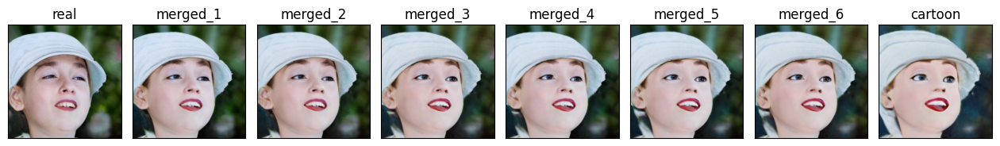

0.23723454773426056


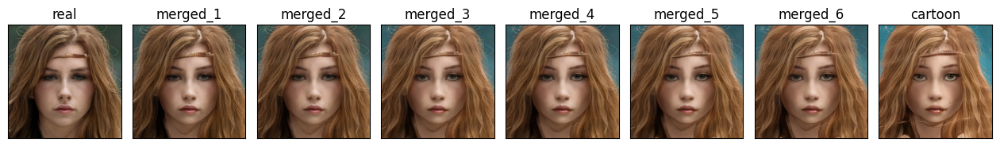

0.29725679755210876


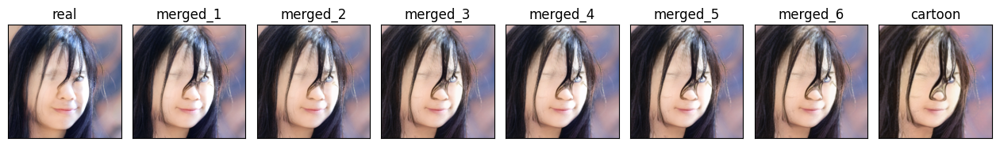

0.4954497218132019


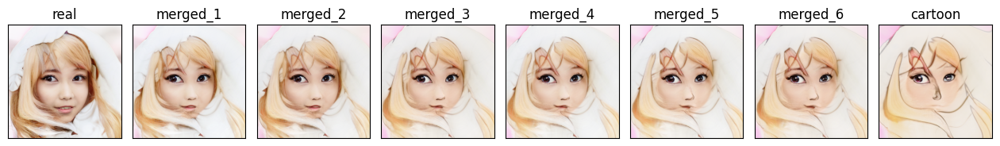

0.24039296805858612


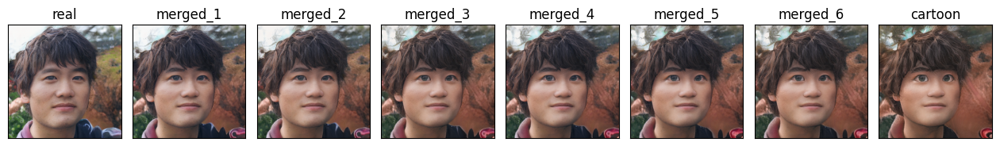

0.3542126417160034


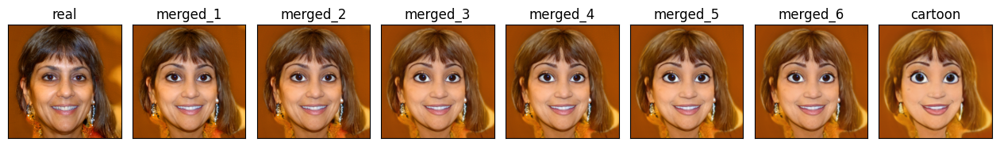

0.39842671155929565


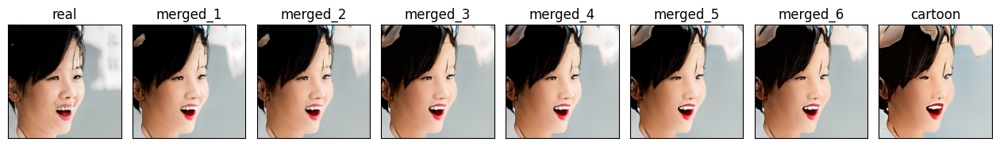

0.3140367865562439


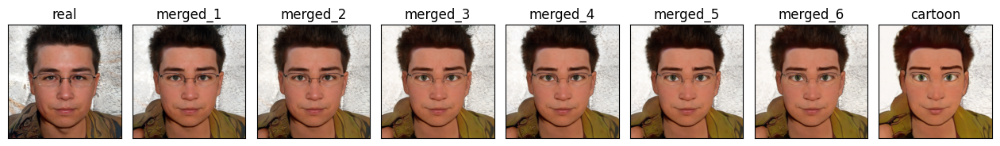

0.34326231479644775


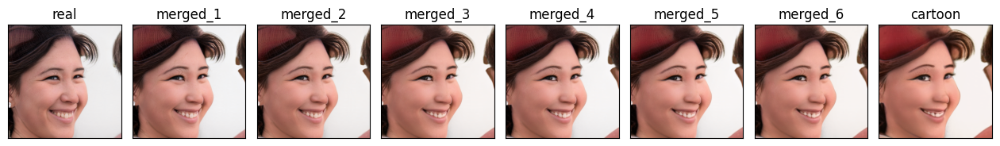

0.5171875357627869


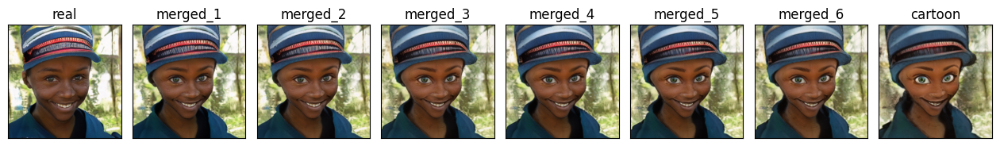

0.5148257613182068


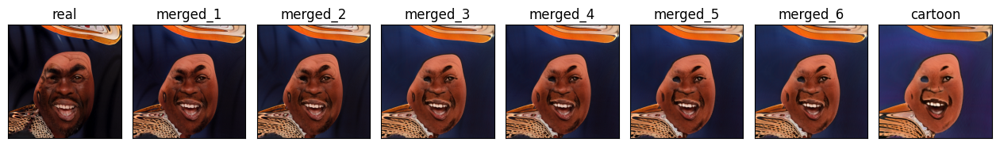

0.4442383646965027


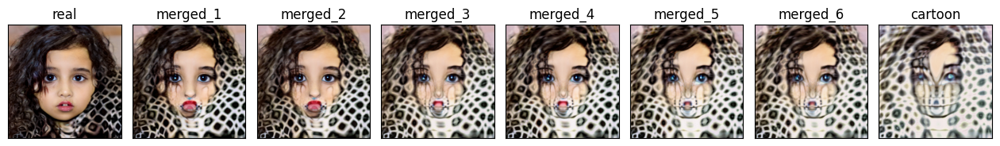

In [27]:
from sklearn.metrics.pairwise import cosine_distances

for i in range(len(seeds)):
    # real_features = extract_features(images['real'][i])
    # cartoon_features = extract_features(images['cartoon'][i])
    # dist = cosine_distances([real_features], [cartoon_features])[0][0]
    
    print(predict_image(images['real'][i]))
    plot_images([images[k][i] for k in images.keys()], list(images.keys()))

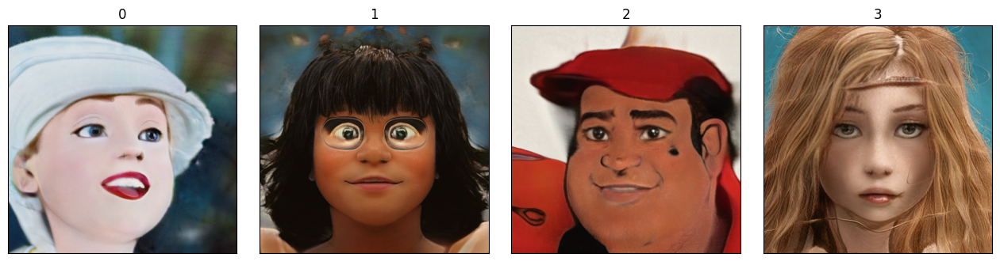

In [31]:
plot_images([images['cartoon'][i] for i in [8, 2, 4, 9]], list(range(4)))

## Generate paired dataset

In [216]:
len(os.listdir('data/paired_data' + '/blended'))

14252

In [215]:
outdir = 'data/paired_data'


blended_models = {
                'real': blend('models/stylegan3-r-ffhq-1024x1024.pkl', 'models/stylegan3-r-ffhq-1024x1024.pkl'),
                'blended': blend('models/stylegan3-r-ffhq-1024x1024-cartoon.pkl', 'models/stylegan3-r-ffhq-1024x1024.pkl',
                                 blend = [0.6, 0.7, 0.8, 0.9, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])
                
                }

for k in blended_models:
   blended_models[k] = blended_models[k].to(device)
   os.makedirs(os.path.join(outdir, k), exist_ok=True)

seeds = np.random.randint(0, 1e6, (25000))

for seed in tqdm(seeds):
    for name in ['real', 'blended']:
      G = blended_models[name]
      z = torch.from_numpy(np.random.RandomState(seed).randn(1, G.z_dim)).to(device)

      if hasattr(G.synthesis, 'input'):
          m = make_transform((0, 0), 0)
          m = np.linalg.inv(m)
          G.synthesis.input.transform.copy_(torch.from_numpy(m))

      img = G(z, torch.zeros([1, G.c_dim], device=device), truncation_psi=1, noise_mode='const')
      img = (img.permute(0, 2, 3, 1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
      img = img[0].cpu().numpy()
      if name == 'real' and predict_image(img) > 0.3:
          break
          
      PIL.Image.fromarray(img, 'RGB').save(f'{outdir}/{name}/seed_{seed}.jpg')

100%|██████████| 25000/25000 [41:32<00:00, 10.03it/s] 


In [68]:
outdir = 'data/my-fake-faces/real'
preds = []
images = []
for filename in tqdm(os.listdir(outdir)[:500]):
    image = cv2.imread(os.path.join(outdir, filename))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    preds.append(predict_image(image))
    images.append(image)
    # plot_images([images[k][i] for k in images.keys()], list(images.keys()))
    

100%|██████████| 500/500 [00:14<00:00, 34.54it/s]


In [69]:
preds = np.array(preds)
images = np.array(images)

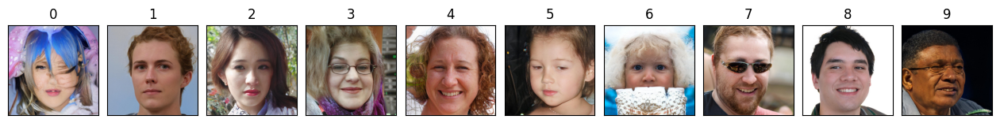

In [80]:
plot_images(images[(preds > 0.5) & (preds < 0.6)][10:10+10], list(range(10)))